# For Sprint 2 codes, please start from Advanced EDA part

In [1]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams
from scipy import stats

## load data to take a glance

In [2]:
df = pd.read_csv('data/business_loan_approved.csv')
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,68355089,NaN,24700.0,24700.0,24700.0,36 months,11.99,820.28,C,C1,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,67715283,NaN,16000.0,16000.0,16000.0,36 months,12.88,538.18,C,C2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,68525638,NaN,14000.0,14000.0,14000.0,60 months,19.89,370.06,E,E3,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
3,68536927,NaN,10000.0,10000.0,10000.0,36 months,11.48,329.67,B,B5,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
4,68566111,NaN,10000.0,10000.0,10000.0,60 months,19.48,262.06,E,E2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


## get basic info for loan status

In [3]:
df['loan_status'].value_counts()

loan_status
Fully Paid                                             10836
Charged Off                                             4580
Late (31-120 days)                                       339
In Grace Period                                          111
Does not meet the credit policy. Status:Fully Paid        89
Does not meet the credit policy. Status:Charged Off       72
Late (16-30 days)                                         71
Name: count, dtype: int64

In [4]:
percentages = df['loan_status'].value_counts(normalize=True) * 100
percentages

loan_status
Fully Paid                                             67.312710
Charged Off                                            28.450739
Late (31-120 days)                                      2.105852
In Grace Period                                         0.689527
Does not meet the credit policy. Status:Fully Paid      0.552864
Does not meet the credit policy. Status:Charged Off     0.447261
Late (16-30 days)                                       0.441049
Name: proportion, dtype: float64

Change the value of loan status:
Fully paid - will be fully paid
Does not meet the credit policy. Status:Fully Paid - Will be fully paid
Rest - charged off
consider fully paid is 1, charged off is 0

In [5]:
df['loan_status'] = np.where(df['loan_status'] == 'Fully Paid', 1,
                    np.where(df['loan_status'] == 'Charged Off', 0,
                    np.where(df['loan_status'] == 'Late (31-120 days)', 0,
                    np.where(df['loan_status'] == 'In Grace Period', 0,
                    np.where(df['loan_status'] == 'Does not meet the credit policy. Status:Fully Paid', 1,
                    np.where(df['loan_status'] == 'Does not meet the credit policy. Status:Charged Off', 0,
                    np.where(df['loan_status'] == 'Late (16-30 days)', 0, -1)))))))

In [6]:
df['loan_status'].value_counts()

loan_status
1    10925
0     5173
Name: count, dtype: int64

In [7]:
import plotly.express as px

In [8]:
ncol = df.dtypes[df.dtypes.values!='object'].index.tolist()

In [9]:
ncol

['id',
 'member_id',
 'loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'int_rate',
 'installment',
 'annual_inc',
 'loan_status',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'mths_since_last_delinq',
 'mths_since_last_record',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'out_prncp',
 'out_prncp_inv',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'collections_12_mths_ex_med',
 'mths_since_last_major_derog',
 'policy_code',
 'annual_inc_joint',
 'dti_joint',
 'acc_now_delinq',
 'tot_coll_amt',
 'tot_cur_bal',
 'open_acc_6m',
 'open_act_il',
 'open_il_12m',
 'open_il_24m',
 'mths_since_rcnt_il',
 'total_bal_il',
 'il_util',
 'open_rv_12m',
 'open_rv_24m',
 'max_bal_bc',
 'all_util',
 'total_rev_hi_lim',
 'inq_fi',
 'total_cu_tl',
 'inq_last_12m',
 'acc_open_past_2

In [10]:
df_cleaned = df.dropna(axis=1)

In [11]:
df_cleaned.shape

(16098, 48)

## Basic EDA

In [12]:
min = df_cleaned['loan_amnt'].min()

min = int(min)
min

500

In [13]:
max  = df_cleaned['loan_amnt'].max()
max= int(max)
max

40000

In [14]:
df_cleaned.head()

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,home_ownership,...,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,policy_code,application_type,acc_now_delinq,delinq_amnt,hardship_flag,disbursement_method,debt_settlement_flag
0,68355089,24700.0,24700.0,24700.0,36 months,11.99,820.28,C,C1,MORTGAGE,...,926.35,699.0,695.0,1.0,Individual,0.0,0.0,N,Cash,N
1,67715283,16000.0,16000.0,16000.0,36 months,12.88,538.18,C,C2,MORTGAGE,...,565.09,629.0,625.0,1.0,Individual,0.0,0.0,N,Cash,N
2,68525638,14000.0,14000.0,14000.0,60 months,19.89,370.06,E,E3,MORTGAGE,...,14190.96,719.0,715.0,1.0,Individual,0.0,0.0,N,Cash,N
3,68536927,10000.0,10000.0,10000.0,36 months,11.48,329.67,B,B5,MORTGAGE,...,346.15,584.0,580.0,1.0,Individual,0.0,0.0,N,Cash,N
4,68566111,10000.0,10000.0,10000.0,60 months,19.48,262.06,E,E2,MORTGAGE,...,8126.54,639.0,635.0,1.0,Individual,0.0,0.0,N,Cash,N


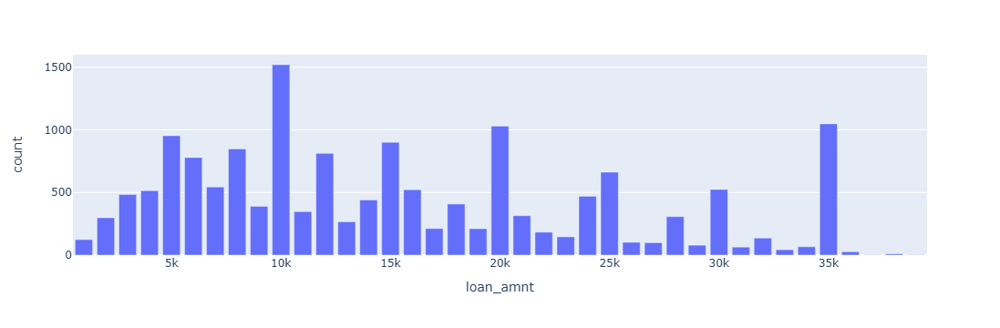

In [15]:
#visualize the loan amount
counts, bins = np.histogram(df.loan_amnt, bins=range(min, max, 1000))
bins = 0.5 * (bins[:-1] + bins[1:])

fig = px.bar(x=bins, y=counts, labels={'x':'loan_amnt', 'y':'count'})
fig.show()


from above, we can tell the majority of loans fall betwen 5K to 35K. $10K is the most common loan amount.

In [16]:
min_int = df_cleaned['int_rate'].min()
min_int = int(min_int)-1
min_int

4

In [17]:
max_int = df_cleaned['int_rate'].max()
max_int = int(max_int)+1
max_int

31

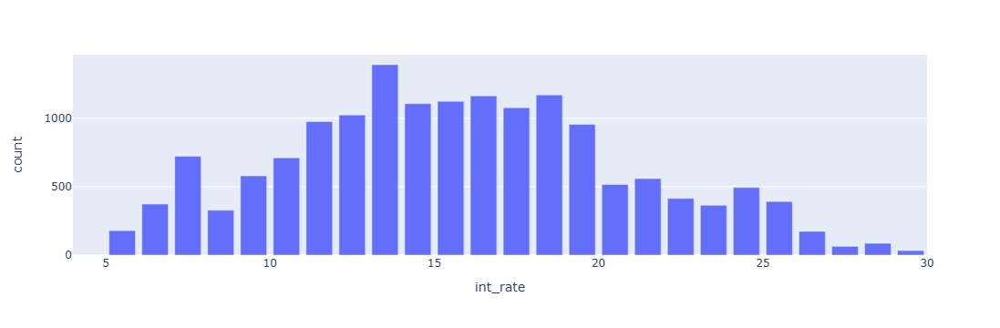

In [18]:
#visualize the interest rates for loans
counts, bins = np.histogram(df.int_rate, bins=range(min_int, max_int, 1))
bins = 0.5 * (bins[:-1] + bins[1:])

fig = px.bar(x=bins, y=counts, labels={'x':'int_rate', 'y':'count'})
fig.show()

We can tell from the above, the interest rates mainly fall between 10% to 20%. with majority of the interest rates fall at 13.5%.

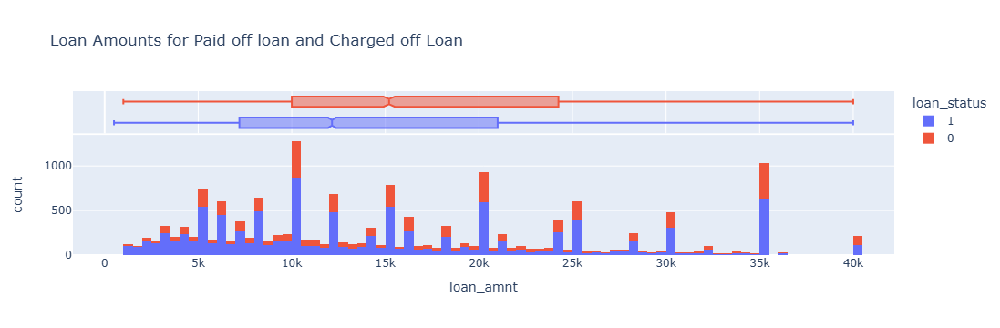

In [19]:
#compare the paid off loan(blue) and charge off loan(red) amounts
fig = px.histogram(df_cleaned, x="loan_amnt", color="loan_status", marginal="box", 
                   title='Loan Amounts for Paid off loan and Charged off Loan',
                         hover_data=df_cleaned.columns)
fig.show()

Based on above, the min, median and max values of charged off loans are all higher than the paid off loans. 

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



Text(0.5, 1.0, 'Interest rates for Paid off loans and charged off loans')

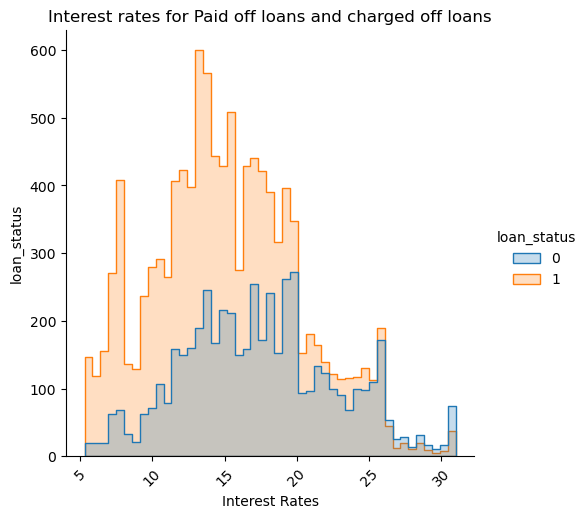

In [20]:
sns.displot(df_cleaned, x='int_rate', hue='loan_status', element="step")
plt.xticks(rotation=45)
plt.xlabel('Interest Rates')
plt.ylabel('loan_status')
plt.title('Interest rates for Paid off loans and charged off loans')


Orange represents the paid off loan while the blue ones represent the charged off loans. 
we can tell the paid off loans are more sknewed towards lower interest rates area while the charged off loans have more towards the higher interest rates.

Now let's look at the correlations

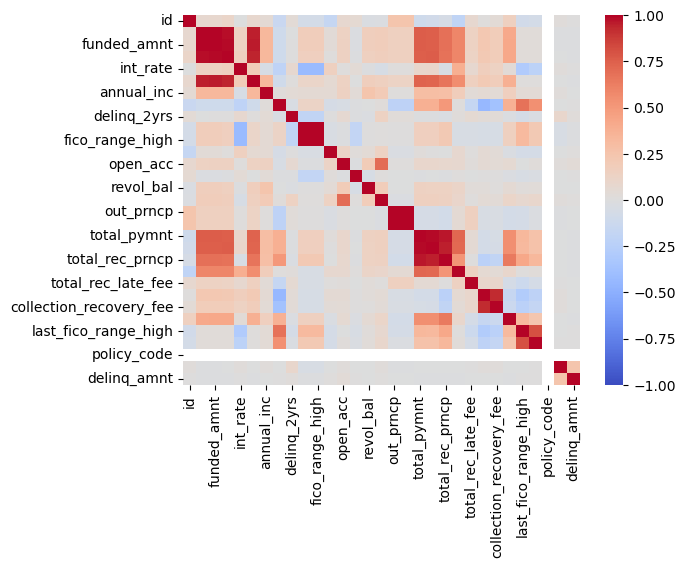

In [21]:
sns.heatmap(df_cleaned.corr(numeric_only=True), center=0, vmin=-1, vmax=1,fmt=".2f",cmap='coolwarm')
plt.show()

There are too many columns to run a heatmap, so we have to reduce columns and convert categorical variable to numerical variable

## Advanced EDA

Change categorical data to numerical data and remove redundancy columns

In [22]:
df_cleaned['term'].value_counts()

term
 36 months    12332
 60 months     3766
Name: count, dtype: int64

In [23]:
df_cleaned['term'] = df_cleaned['term'].replace({'36 months': 36, '60 months': 60})

C:\Users\dfzdf\AppData\Local\Temp\ipykernel_7912\2481163188.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [24]:
df_cleaned['home_ownership'].value_counts()

home_ownership
RENT        7225
MORTGAGE    7122
OWN         1730
OTHER         14
ANY            7
Name: count, dtype: int64

In [25]:
df_cleaned['home_ownership'] = df_cleaned['home_ownership'].map({'RENT': 0, 'MORTGAGE':1, 'OWN':2,'OTHER':0,'ANY':0},)

C:\Users\dfzdf\AppData\Local\Temp\ipykernel_7912\2065225618.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [26]:
df_cleaned['application_type'].value_counts()

application_type
Individual    15798
Joint App       300
Name: count, dtype: int64

In [27]:
#Majority of the application types are individuals, so drop this column.
df_cleaned = df_cleaned.drop('application_type', axis=1, inplace=False)

In [28]:
df_cleaned.head()

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,home_ownership,...,collection_recovery_fee,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,policy_code,acc_now_delinq,delinq_amnt,hardship_flag,disbursement_method,debt_settlement_flag
0,68355089,24700.0,24700.0,24700.0,36 months,11.99,820.28,C,C1,1,...,0.0,926.35,699.0,695.0,1.0,0.0,0.0,N,Cash,N
1,67715283,16000.0,16000.0,16000.0,36 months,12.88,538.18,C,C2,1,...,0.0,565.09,629.0,625.0,1.0,0.0,0.0,N,Cash,N
2,68525638,14000.0,14000.0,14000.0,60 months,19.89,370.06,E,E3,1,...,0.0,14190.96,719.0,715.0,1.0,0.0,0.0,N,Cash,N
3,68536927,10000.0,10000.0,10000.0,36 months,11.48,329.67,B,B5,1,...,0.0,346.15,584.0,580.0,1.0,0.0,0.0,N,Cash,N
4,68566111,10000.0,10000.0,10000.0,60 months,19.48,262.06,E,E2,1,...,0.0,8126.54,639.0,635.0,1.0,0.0,0.0,N,Cash,N


In [29]:
df_cleaned['grade'].value_counts()

grade
C    4113
D    3745
B    2666
E    2412
A    1485
F    1162
G     515
Name: count, dtype: int64

In [30]:
df_cleaned['grade'] = df_cleaned['grade'].map({'A': 0, 'B':1,'C':2,'D':3,'E':4,'F':5,'G':6,})

In [31]:
df_cleaned.describe

<bound method NDFrame.describe of              id  loan_amnt  funded_amnt  funded_amnt_inv        term  \
0      68355089    24700.0      24700.0          24700.0   36 months   
1      67715283    16000.0      16000.0          16000.0   36 months   
2      68525638    14000.0      14000.0          14000.0   60 months   
3      68536927    10000.0      10000.0          10000.0   36 months   
4      68566111    10000.0      10000.0          10000.0   60 months   
...         ...        ...          ...              ...         ...   
16093  90693354     6400.0       6400.0           6400.0   36 months   
16094  90331777     9600.0       9600.0           9600.0   36 months   
16095  90130178    20000.0      20000.0          19975.0   36 months   
16096  90106158    16800.0      16800.0          16800.0   60 months   
16097  89906326    19250.0      19250.0          19250.0   36 months   

       int_rate  installment  grade sub_grade  home_ownership  ...  \
0         11.99       820.28   

In [32]:
df_cleaned.info

<bound method DataFrame.info of              id  loan_amnt  funded_amnt  funded_amnt_inv        term  \
0      68355089    24700.0      24700.0          24700.0   36 months   
1      67715283    16000.0      16000.0          16000.0   36 months   
2      68525638    14000.0      14000.0          14000.0   60 months   
3      68536927    10000.0      10000.0          10000.0   36 months   
4      68566111    10000.0      10000.0          10000.0   60 months   
...         ...        ...          ...              ...         ...   
16093  90693354     6400.0       6400.0           6400.0   36 months   
16094  90331777     9600.0       9600.0           9600.0   36 months   
16095  90130178    20000.0      20000.0          19975.0   36 months   
16096  90106158    16800.0      16800.0          16800.0   60 months   
16097  89906326    19250.0      19250.0          19250.0   36 months   

       int_rate  installment  grade sub_grade  home_ownership  ...  \
0         11.99       820.28     

In [33]:
df_cleaned.dtypes

id                           int64
loan_amnt                  float64
funded_amnt                float64
funded_amnt_inv            float64
term                        object
int_rate                   float64
installment                float64
grade                        int64
sub_grade                   object
home_ownership               int64
annual_inc                 float64
verification_status         object
issue_d                     object
loan_status                  int32
pymnt_plan                  object
url                         object
purpose                     object
zip_code                    object
addr_state                  object
delinq_2yrs                float64
earliest_cr_line            object
fico_range_low             float64
fico_range_high            float64
inq_last_6mths             float64
open_acc                   float64
pub_rec                    float64
revol_bal                  float64
total_acc                  float64
initial_list_status 

In [34]:
#drop columns that are duplicated or had little impact on the model
df_cleaned = df_cleaned.drop(
    ['funded_amnt', 'funded_amnt_inv', 'sub_grade', 'verification_status', 
     'disbursement_method', 'hardship_flag', 'url', 'collection_recovery_fee', 
     'debt_settlement_flag', 'policy_code', 'initial_list_status','zip_code'], 
    axis=1, 
    inplace=False)

In [35]:
df_cleaned = df_cleaned.drop(
    ['acc_now_delinq', 'earliest_cr_line', 'total_rec_late_fee', 'total_pymnt', 
     'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 'recoveries', 
     ], 
    axis=1, 
    inplace=False)

In [36]:
df_cleaned.dtypes

id                        int64
loan_amnt               float64
term                     object
int_rate                float64
installment             float64
grade                     int64
home_ownership            int64
annual_inc              float64
issue_d                  object
loan_status               int32
pymnt_plan               object
purpose                  object
addr_state               object
delinq_2yrs             float64
fico_range_low          float64
fico_range_high         float64
inq_last_6mths          float64
open_acc                float64
pub_rec                 float64
revol_bal               float64
total_acc               float64
out_prncp               float64
out_prncp_inv           float64
last_pymnt_amnt         float64
last_fico_range_high    float64
last_fico_range_low     float64
delinq_amnt             float64
dtype: object

In [37]:
df_cleaned['pymnt_plan'].value_counts()

pymnt_plan
n    16092
y        6
Name: count, dtype: int64

In [38]:
#remove payment plans as the majority of data are one type, also remove purpose and address
df_cleaned = df_cleaned.drop(
    ['pymnt_plan',  'purpose', 'addr_state', 
     ], 
    axis=1, 
    inplace=False)

In [39]:
df_cleaned['term'].value_counts()

term
 36 months    12332
 60 months     3766
Name: count, dtype: int64

In [40]:
df_cleaned['issue_d'] = pd.to_datetime(df_cleaned['issue_d'], format='%b-%Y')

In [41]:
df_cleaned['term'] = df_cleaned['term'].replace({' 36 months': 36, ' 60 months': 60})
df_cleaned['term'] = df_cleaned['term'].astype(int)
df_cleaned.head()

,id,loan_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,issue_d,loan_status,...,open_acc,pub_rec,revol_bal,total_acc,out_prncp,out_prncp_inv,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,delinq_amnt
0,68355089,24700.0,36,11.99,820.28,2,1,65000.0,2015-12-01,1,...,22.0,0.0,21470.0,38.0,0.0,0.0,926.35,699.0,695.0,0.0
1,67715283,16000.0,36,12.88,538.18,2,1,65000.0,2015-12-01,0,...,7.0,1.0,5157.0,20.0,0.0,0.0,565.09,629.0,625.0,0.0
2,68525638,14000.0,60,19.89,370.06,4,1,80000.0,2015-12-01,1,...,13.0,0.0,28820.0,28.0,0.0,0.0,14190.96,719.0,715.0,0.0
3,68536927,10000.0,36,11.48,329.67,1,1,105000.0,2015-12-01,0,...,11.0,2.0,4268.0,37.0,0.0,0.0,346.15,584.0,580.0,0.0
4,68566111,10000.0,60,19.48,262.06,4,1,117000.0,2015-12-01,1,...,8.0,0.0,1931.0,12.0,0.0,0.0,8126.54,639.0,635.0,0.0


In [42]:
n_columns = df_cleaned.dtypes[df_cleaned.dtypes.values!='object'].index.tolist()
n_columns

['id',
 'loan_amnt',
 'term',
 'int_rate',
 'installment',
 'grade',
 'home_ownership',
 'annual_inc',
 'issue_d',
 'loan_status',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'total_acc',
 'out_prncp',
 'out_prncp_inv',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'delinq_amnt']

In [43]:
df_cleaned.dtypes

id                               int64
loan_amnt                      float64
term                             int32
int_rate                       float64
installment                    float64
grade                            int64
home_ownership                   int64
annual_inc                     float64
issue_d                 datetime64[ns]
loan_status                      int32
delinq_2yrs                    float64
fico_range_low                 float64
fico_range_high                float64
inq_last_6mths                 float64
open_acc                       float64
pub_rec                        float64
revol_bal                      float64
total_acc                      float64
out_prncp                      float64
out_prncp_inv                  float64
last_pymnt_amnt                float64
last_fico_range_high           float64
last_fico_range_low            float64
delinq_amnt                    float64
dtype: object

In [44]:

related_columns = ['loan_status','term',
 'int_rate',
 'installment',
 'grade',
 'home_ownership',
 'annual_inc',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'total_acc',
 'out_prncp',
 'out_prncp_inv',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'delinq_amnt']

correlation_matrix = df_cleaned[related_columns].corr()

print(correlation_matrix)

                      loan_status      term  int_rate  installment     grade  \
loan_status              1.000000 -0.163337 -0.208142    -0.095432 -0.190929   
term                    -0.163337  1.000000  0.334985     0.094684  0.344922   
int_rate                -0.208142  0.334985  1.000000     0.190618  0.943179   
installment             -0.095432  0.094684  0.190618     1.000000  0.170627   
grade                   -0.190929  0.344922  0.943179     0.170627  1.000000   
home_ownership           0.049215  0.037472 -0.060584     0.072790 -0.059144   
annual_inc               0.018872  0.027184 -0.053517     0.330176 -0.041528   
delinq_2yrs             -0.032846 -0.007324  0.071562     0.010737  0.077103   
fico_range_low           0.121154  0.042729 -0.423696     0.104646 -0.427446   
fico_range_high          0.121151  0.042726 -0.423695     0.104645 -0.427444   
inq_last_6mths          -0.055616  0.003362  0.151100     0.058058  0.173873   
open_acc                -0.041970  0.057

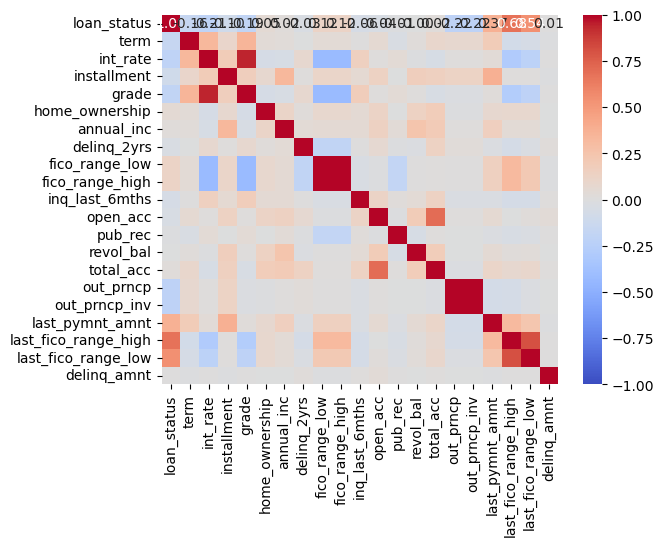

In [45]:
sns.heatmap(correlation_matrix, annot = True, center=0, vmin=-1, vmax=1,fmt=".2f",cmap='coolwarm')
plt.show()

From the heatmap above, we can see the whether a business can payoff its loan is highly related to the Fico Score and last payment amount.
negatively related to the loan amounts and interest rates and grades.

# Visualize numeric data

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a

IndexError: list index out of range

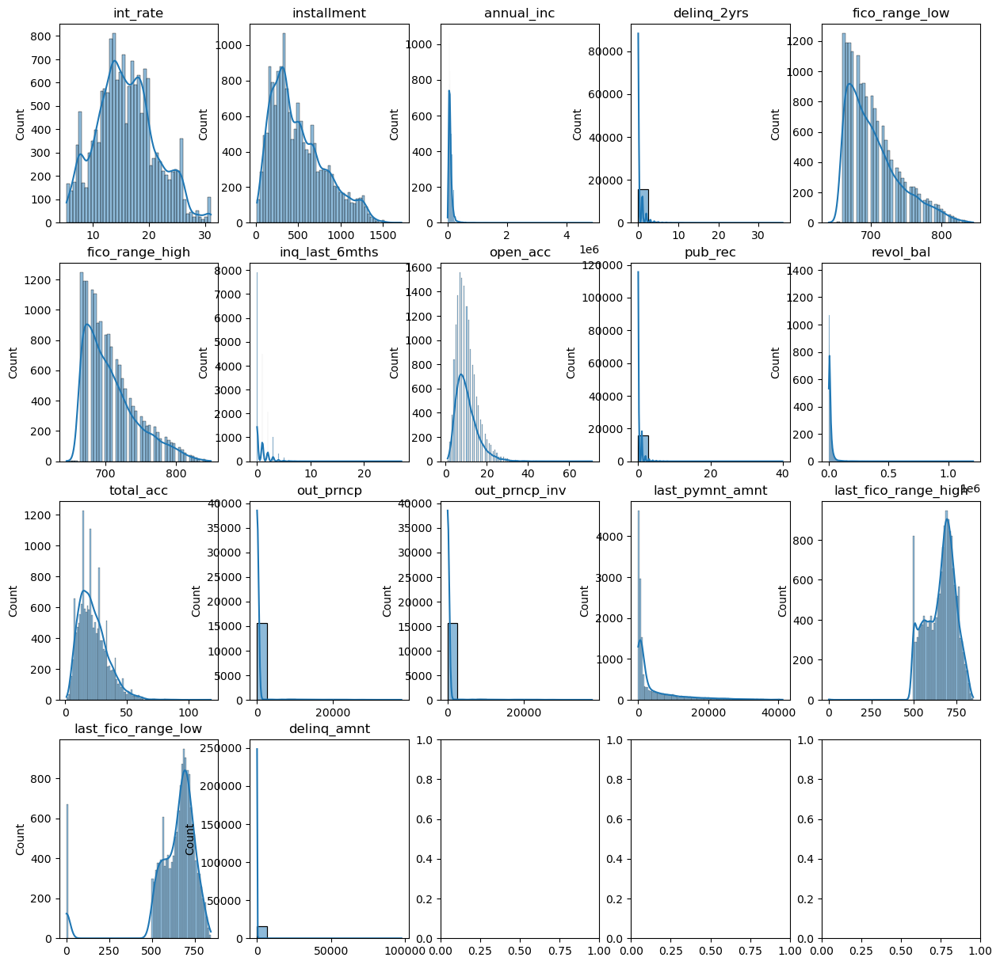

In [46]:
fig, axes = plt.subplots(4, 5, figsize=(15, 15))
num_column= [
 'int_rate',
 'installment',
 'annual_inc',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'total_acc',
 'out_prncp',
 'out_prncp_inv',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'delinq_amnt']
for i, ax in enumerate(axes.flatten()):
    sns.histplot(df_cleaned[num_column[i]], kde=True, ax=ax)
    ax.set_title(num_column[i])
    ax.set_xlabel('')
plt.tight_layout()

# Visualize categorical data

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



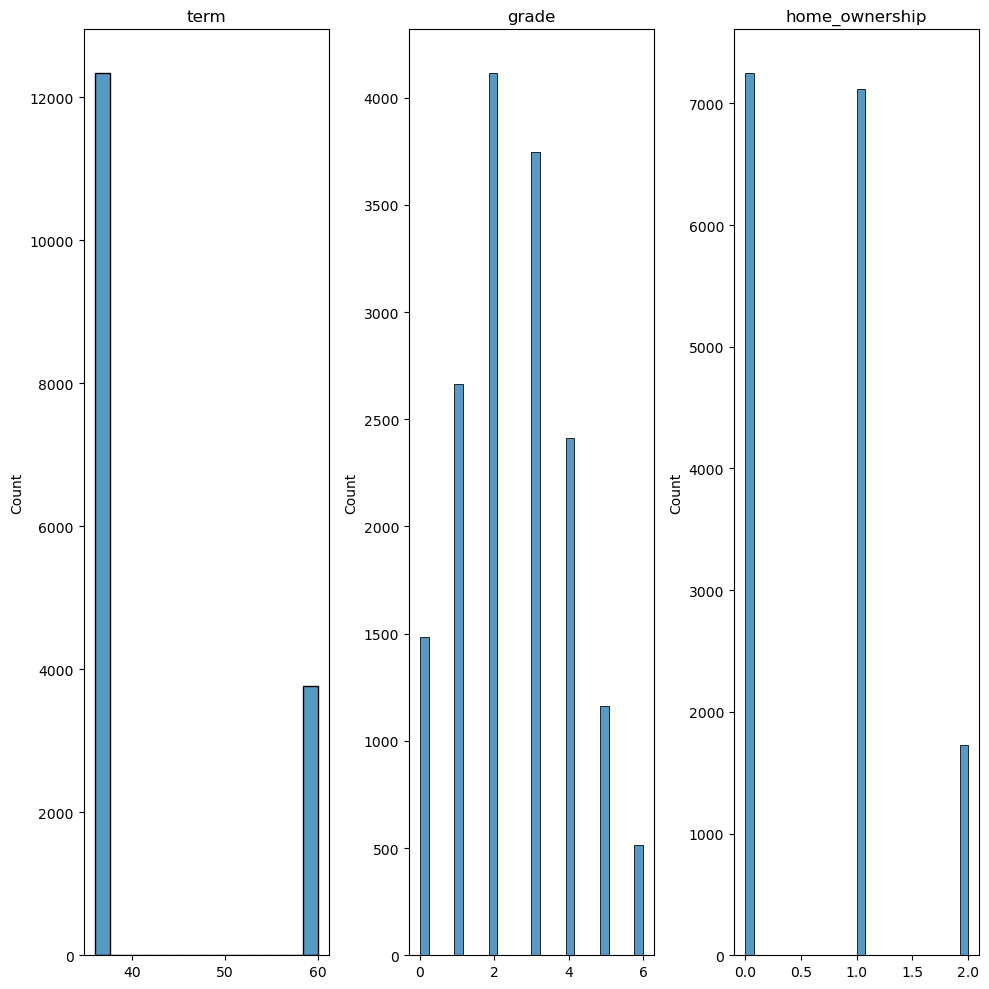

In [47]:
fig, axes = plt.subplots(1, 3, figsize=(10, 10))
cat_column= ['term', 'grade', 'home_ownership',]
for i, ax in enumerate(axes.flatten()):
    sns.histplot(df_cleaned[cat_column[i]], ax=ax)
    ax.set_title(cat_column[i])
    ax.set_xlabel('')
plt.tight_layout()

# scaling numeric features

In [48]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

numerical_features = ['int_rate',
 'installment',
 'annual_inc',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'total_acc',
 'out_prncp',
 'out_prncp_inv',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low']

df_cleaned[numerical_features] = scaler.fit_transform(df_cleaned[numerical_features])

Visualize the numerical columns after scaling

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a

IndexError: list index out of range

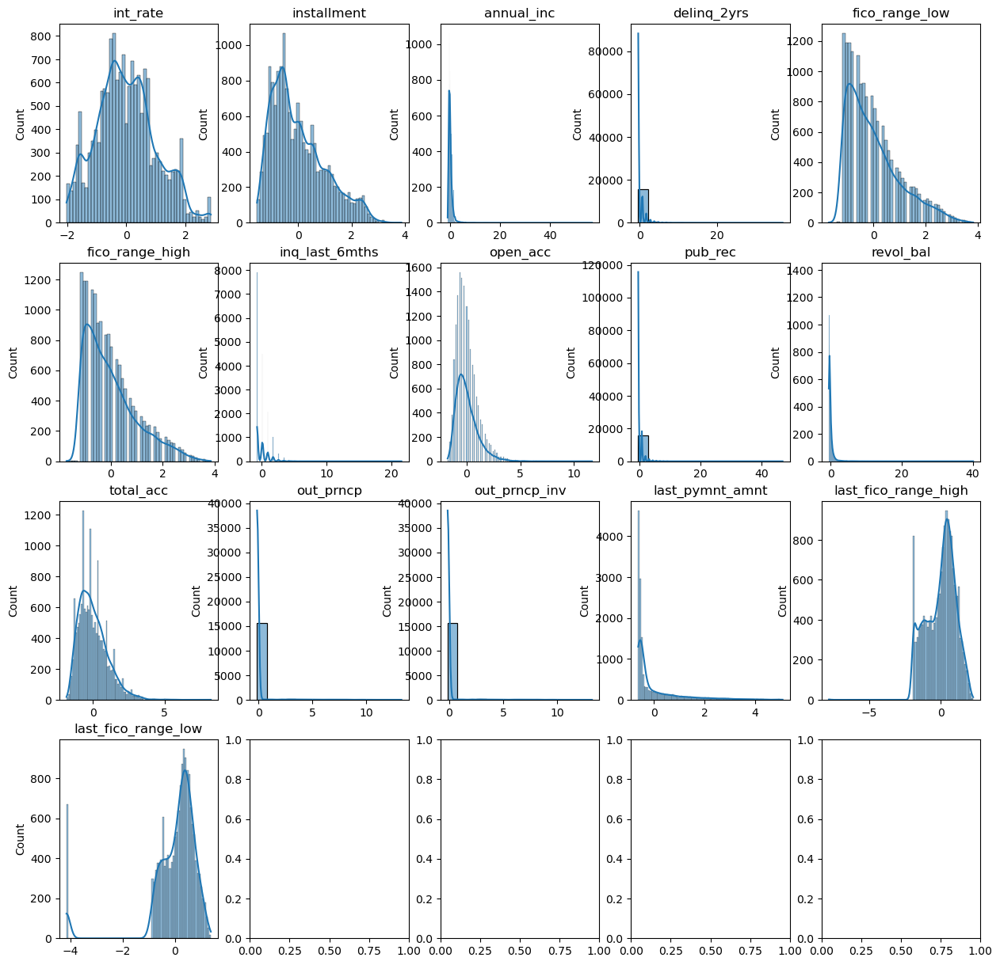

In [49]:
fig, axes = plt.subplots(4, 5, figsize=(15, 15))
for i, ax in enumerate(axes.flatten()):
    sns.histplot(df_cleaned[numerical_features[i]], kde=True, ax=ax)
    ax.set_title(numerical_features[i])
    ax.set_xlabel('')
plt.tight_layout()

# split the dataset and build a model

## Random Forecast

In [50]:
df_cleaned = df_cleaned.drop('issue_d', axis=1, inplace=False)

In [51]:
from sklearn.model_selection import train_test_split

X = df_cleaned.drop('loan_status', axis=1)
y = df_cleaned['loan_status']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [52]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

accuracy, report, conf_matrix

(0.9142857142857143,
 '              precision    recall  f1-score   support\n\n           0       0.87      0.87      0.87      1031\n           1       0.94      0.94      0.94      2189\n\n    accuracy                           0.91      3220\n   macro avg       0.90      0.90      0.90      3220\nweighted avg       0.91      0.91      0.91      3220\n',
 array([[ 894,  137],
        [ 139, 2050]], dtype=int64))

Accuracy - 91.43% this means the model correctly predicted the class 91.43% of the time
For loan status equal to 1(fully paid), the model accuracy is 94%, and for loan status as default/ not fully paid, the model accuracy is 87%.

## From the above, we can tell the model is better forecast the Class 1.
## Given Loan status = 1 has 10925 rows while loan status has 5273 rows, the model has inbalance class distributions, which results the better forecasting Class 1.
## We will resampling the data to increase Class 0 or over-sampling Class 0 to improve model accuracy.

## ANN

In [53]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers


In [54]:

X = df_cleaned.drop('loan_status', axis=1)
y = df_cleaned['loan_status']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [55]:
# random seeds for reproducibility
tf.random.set_seed(1111)

# Create a new Sequential model
model = keras.Sequential()

# Declare the hidden layer with a single neuron and a relu activation function
model.add(layers.Dense(1, activation="relu"))

# Declare the output layer
model.add(layers.Dense(1, activation="sigmoid")) # For binary classification, we need one output neuron with a sigmoid activation

In [56]:
model.compile(
    # Optimizer
    optimizer=keras.optimizers.Adam(),
    # Loss function to minimize
    loss=keras.losses.BinaryCrossentropy(),
    # Metric used to evaluate model
    metrics=[keras.metrics.BinaryAccuracy()]
)

In [57]:
history = model.fit(X_train, y_train, epochs=100, verbose=1)

Epoch 1/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - binary_accuracy: 0.6770 - loss: 0.6791
Epoch 2/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - binary_accuracy: 0.6790 - loss: 0.6442
Epoch 3/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - binary_accuracy: 0.6789 - loss: 0.6322
Epoch 4/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - binary_accuracy: 0.6790 - loss: 0.6287
Epoch 5/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - binary_accuracy: 0.6790 - loss: 0.6279
Epoch 6/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - binary_accuracy: 0.6788 - loss: 0.6278
Epoch 7/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - binary_accuracy: 0.6789 - loss: 0.6277
Epoch 8/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - binary_accuracy: 0.6791 - loss: 0.6276
Epoch 9/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - binary_accuracy: 0.6791 - loss: 0.6276
Epoch 10/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - binary_accuracy: 0.6789 - loss: 0.6277
Epoch 11/100
403/403 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - bin

In [ ]:
# Evaluate the network
train_accuracy = history.history["binary_accuracy"][-1]
result = model.evaluate(X_test,y_test, verbose=0)

print(f"Train Accuracy: {train_accuracy:.4f}")
print(f"Test Accuracy: {result[1]:.4f}")

# Generate predictions
predictions = model.predict(X_test)

The accuracy score is 0.68%, which is lower than the Random Forrest model